In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sqlalchemy import create_engine, text
from scipy.stats import zscore
import psycopg2
import os
import plotly.express as px
import random
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import plotly.graph_objects as go
from scipy.spatial import distance
from sklearn.metrics import pairwise_distances_argmin_min
from functools import reduce
from scipy.stats.mstats import winsorize

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import Ridge
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import RidgeCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

In [3]:
os.chdir('../..')

In [9]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
os.getcwd()

'c:\\Users\\user\\Downloads\\ten_academy\\week1\\Week1-10Academy-User-Analysis'

In [5]:
df = pd.read_csv('data/tel_dump.csv')

In [6]:
df.columns

Index(['Bearer Id', 'Start', 'Start ms', 'End', 'End ms', 'Dur. (ms)', 'IMSI',
       'MSISDN/Number', 'IMEI', 'Last Location Name', 'Avg RTT DL (ms)',
       'Avg RTT UL (ms)', 'Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)',
       'TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)',
       'DL TP < 50 Kbps (%)', '50 Kbps < DL TP < 250 Kbps (%)',
       '250 Kbps < DL TP < 1 Mbps (%)', 'DL TP > 1 Mbps (%)',
       'UL TP < 10 Kbps (%)', '10 Kbps < UL TP < 50 Kbps (%)',
       '50 Kbps < UL TP < 300 Kbps (%)', 'UL TP > 300 Kbps (%)',
       'HTTP DL (Bytes)', 'HTTP UL (Bytes)', 'Activity Duration DL (ms)',
       'Activity Duration UL (ms)', 'Dur. (ms).1', 'Handset Manufacturer',
       'Handset Type', 'Nb of sec with 125000B < Vol DL',
       'Nb of sec with 1250B < Vol UL < 6250B',
       'Nb of sec with 31250B < Vol DL < 125000B',
       'Nb of sec with 37500B < Vol UL',
       'Nb of sec with 6250B < Vol DL < 31250B',
       'Nb of sec with 6250B < Vol UL < 37500B',


In [7]:
# Relevant features for clustering
features = ['Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)']

In [8]:
# Convert 'Start' and 'End' columns to datetime
df['Start'] = pd.to_datetime(df['Start'])
df['End'] = pd.to_datetime(df['End'])

# Calculate session duration
df['Session Duration (ms)'] = (df['End'] - df['Start']).dt.total_seconds() * 1000

# Calculate total traffic for each session (download + upload)
df['Total Traffic (Bytes)'] = df['Total DL (Bytes)'] + df['Total UL (Bytes)']

# Group by 'MSISDN/Number' to calculate metrics for each user
user_engagement = df.groupby('MSISDN/Number').agg({
    'Start': 'count',                           # Sessions frequency
    'Session Duration (ms)': 'mean',           # Average session duration
    'Total Traffic (Bytes)': 'sum'             # Total traffic for all sessions
})

# Rename columns for better readability
user_engagement = user_engagement.rename(columns={
    'Start': 'Sessions Frequency',
    'Session Duration (ms)': 'Average Session Duration (ms)',
    'Total Traffic (Bytes)': 'Total Traffic (Bytes)'
})

# Display the result
print(user_engagement)

               Sessions Frequency  Average Session Duration (ms)  \
MSISDN/Number                                                      
3.360100e+10                    1                    116760000.0   
3.360100e+10                    1                    181260000.0   
3.360100e+10                    1                    135000000.0   
3.360101e+10                    1                     49920000.0   
3.360101e+10                    2                     18600000.0   
...                           ...                            ...   
3.379000e+10                    1                      8760000.0   
3.379000e+10                    1                    141000000.0   
3.197021e+12                    1                    877380000.0   
3.370000e+14                    1                    253020000.0   
8.823971e+14                    1                    869820000.0   

               Total Traffic (Bytes)  
MSISDN/Number                         
3.360100e+10            8.786906e+08 

In [9]:
# Normalize the engagement metrics
scaler = StandardScaler()
normalized_engagement = scaler.fit_transform(user_engagement)

# Run k-means clustering with k=3
kmeans = KMeans(n_clusters=3, random_state=42)
user_engagement['Cluster'] = kmeans.fit_predict(normalized_engagement)

# Display the results
print("Customers Classified into 3 Groups of Engagement:")
print(user_engagement)

Customers Classified into 3 Groups of Engagement:
               Sessions Frequency  Average Session Duration (ms)  \
MSISDN/Number                                                      
3.360100e+10                    1                    116760000.0   
3.360100e+10                    1                    181260000.0   
3.360100e+10                    1                    135000000.0   
3.360101e+10                    1                     49920000.0   
3.360101e+10                    2                     18600000.0   
...                           ...                            ...   
3.379000e+10                    1                      8760000.0   
3.379000e+10                    1                    141000000.0   
3.197021e+12                    1                    877380000.0   
3.370000e+14                    1                    253020000.0   
8.823971e+14                    1                    869820000.0   

               Total Traffic (Bytes)  Cluster  
MSISDN/Number    

In [10]:
# Fit k-means with the selected number of clusters
kmeans = KMeans(n_clusters=3, random_state=42)
user_engagement['Cluster'] = kmeans.fit_predict(normalized_engagement)

# Determine which cluster has lower engagement based on, for example, 'Sessions Frequency'
less_engaged_cluster = user_engagement.groupby('Cluster')['Sessions Frequency'].mean().idxmin()

# Calculate Euclidean distances to the centroids
distances = pairwise_distances_argmin_min(normalized_engagement, kmeans.cluster_centers_)[1]

# Reset the index before accessing 'MSISDN/Number' column
user_engagement.reset_index(inplace=True)

# Assign engagement scores based on the less engaged cluster
user_engagement['Engagement Score'] = distances if less_engaged_cluster == 0 else -distances

In [11]:
# Display the results
print("Customers with Engagement Scores:")
print(user_engagement[['MSISDN/Number', 'Engagement Score']])

Customers with Engagement Scores:
        MSISDN/Number  Engagement Score
0        3.360100e+10         -0.987513
1        3.360100e+10         -0.780151
2        3.360100e+10         -0.789639
3        3.360101e+10         -0.383721
4        3.360101e+10         -1.486577
...               ...               ...
106851   3.379000e+10         -0.932287
106852   3.379000e+10         -0.703207
106853   3.197021e+12         -9.529861
106854   3.370000e+14         -0.888826
106855   8.823971e+14         -9.439481

[106856 rows x 2 columns]


In [12]:
# Sort the DataFrame by 'Engagement Score' in descending order and select the top 10 rows
top_10_engaged_customers = user_engagement['Engagement Score'].sort_values(ascending=False).head(10)

# Create a new DataFrame with the index as 'MSISDN/Number' and 'Engagement Score' as the only column
top_10_df = pd.DataFrame({'Engagement Score': top_10_engaged_customers.values})

# Reset the index to use default integer index (1, 2, 3, ...)
top_10_df.reset_index(inplace=True, drop=True)

# Plot the top 10 customers using a bar chart with the default integer index as x-axis
fig = px.bar(top_10_df, x=top_10_df.index + 1, y='Engagement Score', title='Top 10 Engaged Customers')

# Customize the layout if needed
fig.update_layout(xaxis_title='Rank', yaxis_title='Engagement Score')

# Show the plot
fig.show()

In [13]:
top_10_engaged_customers

103879   -0.135665
38004    -0.135840
15971    -0.135840
94728    -0.135878
18477    -0.135993
39461    -0.136106
49016    -0.136108
20224    -0.136377
60104    -0.136438
103375   -0.137075
Name: Engagement Score, dtype: float64

In [14]:
# Group by customer and calculate the mean for both DL and UL throughput
grouped_data_throughput = df.groupby('MSISDN/Number').agg({
    'Avg Bearer TP DL (kbps)': 'mean',
    'Avg Bearer TP UL (kbps)': 'mean'
}).reset_index()

# Treat missing values by replacing them with the mean
grouped_data_throughput['Avg Bearer TP DL (kbps)'].fillna(grouped_data_throughput['Avg Bearer TP DL (kbps)'].mean(), inplace=True)
grouped_data_throughput['Avg Bearer TP UL (kbps)'].fillna(grouped_data_throughput['Avg Bearer TP UL (kbps)'].mean(), inplace=True)

# Display the resulting DataFrame
print(grouped_data_throughput)

        MSISDN/Number  Avg Bearer TP DL (kbps)  Avg Bearer TP UL (kbps)
0        3.360100e+10                     37.0                     39.0
1        3.360100e+10                     48.0                     51.0
2        3.360100e+10                     48.0                     49.0
3        3.360101e+10                    204.0                     44.0
4        3.360101e+10                  20197.5                   8224.5
...               ...                      ...                      ...
106851   3.379000e+10                   9978.0                    387.0
106852   3.379000e+10                     68.0                     48.0
106853   3.197021e+12                      1.0                      0.0
106854   3.370000e+14                     11.0                     22.0
106855   8.823971e+14                      2.0                      0.0

[106856 rows x 3 columns]


In [15]:
grouped_data_rtt = df.groupby('MSISDN/Number')['Avg RTT DL (ms)'].mean().reset_index()

# Treat missing values by replacing them with the mean
grouped_data_rtt['Avg RTT DL (ms)'].fillna(grouped_data_rtt['Avg RTT DL (ms)'].mean(), inplace=True)

# Handling outliers (you can use a different method if needed)
mean_value_rtt = grouped_data_rtt['Avg RTT DL (ms)'].mean()
std_dev_rtt = grouped_data_rtt['Avg RTT DL (ms)'].std()

# Define a threshold for outliers (you can adjust this threshold)
outlier_threshold_rtt = 3

# Replace outliers with the mean value
grouped_data_rtt['Avg RTT DL (ms)'] = grouped_data_rtt['Avg RTT DL (ms)'].apply(
    lambda x: mean_value_rtt if abs(x - mean_value_rtt) > outlier_threshold_rtt * std_dev_rtt else x
)

# Display the resulting DataFrame
print(grouped_data_rtt)

        MSISDN/Number  Avg RTT DL (ms)
0        3.360100e+10        46.000000
1        3.360100e+10        30.000000
2        3.360100e+10       119.182869
3        3.360101e+10        69.000000
4        3.360101e+10        57.000000
...               ...              ...
106851   3.379000e+10        42.000000
106852   3.379000e+10        34.000000
106853   3.197021e+12       119.182869
106854   3.370000e+14       119.182869
106855   8.823971e+14       119.182869

[106856 rows x 2 columns]


In [16]:
grouped_data_retrans = df.groupby('MSISDN/Number')['TCP DL Retrans. Vol (Bytes)'].mean().reset_index()

# Treat missing values by replacing them with the mean
grouped_data_retrans['TCP DL Retrans. Vol (Bytes)'].fillna(grouped_data_retrans['TCP DL Retrans. Vol (Bytes)'].mean(), inplace=True)

# Handling outliers (you can use a different method if needed)
mean_value = grouped_data_retrans['TCP DL Retrans. Vol (Bytes)'].mean()
std_dev = grouped_data_retrans['TCP DL Retrans. Vol (Bytes)'].std()

# Define a threshold for outliers (you can adjust this threshold)
outlier_threshold = 3

# Replace outliers with the mean value
grouped_data_retrans['TCP DL Retrans. Vol (Bytes)'] = grouped_data_retrans['TCP DL Retrans. Vol (Bytes)'].apply(
    lambda x: mean_value if abs(x - mean_value) > outlier_threshold * std_dev else x
)

# Display the resulting DataFrame
print(grouped_data_retrans)

        MSISDN/Number  TCP DL Retrans. Vol (Bytes)
0        3.360100e+10                 1.685339e+07
1        3.360100e+10                 1.685339e+07
2        3.360100e+10                 1.685339e+07
3        3.360101e+10                 1.066000e+03
4        3.360101e+10                 9.349630e+06
...               ...                          ...
106851   3.379000e+10                 2.150440e+05
106852   3.379000e+10                 1.685339e+07
106853   3.197021e+12                 1.685339e+07
106854   3.370000e+14                 1.685339e+07
106855   8.823971e+14                 1.685339e+07

[106856 rows x 2 columns]


In [17]:
# Group by 'MSISDN/Number' and calculate the mode for 'Handset Type'
grouped_data_handset = df.groupby('MSISDN/Number')['Handset Type'].agg(lambda x: x.mode().iat[0] if not x.mode().empty else None).reset_index()

# Group by 'Handset Type' and calculate the mean for 'TCP DL Retrans. Vol (Bytes)'
grouped_data_tcp = df.groupby('Handset Type')['TCP DL Retrans. Vol (Bytes)'].mean().reset_index()

# Merge the datasets on 'Handset Type'
merged_data = pd.merge(grouped_data_handset, grouped_data_tcp, on='Handset Type')

# Display the resulting DataFrame
print(merged_data)

        MSISDN/Number                                    Handset Type  \
0        3.360100e+10                  Huawei P20 Lite Huawei Nova 3E   
1        3.360126e+10                  Huawei P20 Lite Huawei Nova 3E   
2        3.360127e+10                  Huawei P20 Lite Huawei Nova 3E   
3        3.360128e+10                  Huawei P20 Lite Huawei Nova 3E   
4        3.360137e+10                  Huawei P20 Lite Huawei Nova 3E   
...               ...                                             ...   
106851   3.378689e+10  Huawei Mate 9 Pro Porsche Design Huawei Mate 9   
106852   3.378712e+10                     Ddm Brands Llc Andy 5El Lte   
106853   3.378853e+10                Vivo Mobile Comm. Vivo Vivo X21A   
106854   3.197021e+12                Quectel Wireless. Quectel Ec25-E   
106855   8.823971e+14                Quectel Wireless. Quectel Ec21-E   

        TCP DL Retrans. Vol (Bytes)  
0                      2.623121e+06  
1                      2.623121e+06  
2        

In [18]:
# Combine features from different DataFrames
consolidated_data = pd.merge(grouped_data_handset, grouped_data_retrans, on='MSISDN/Number')
consolidated_data = pd.merge(consolidated_data, grouped_data_rtt, on='MSISDN/Number')
consolidated_data = pd.merge(consolidated_data, grouped_data_throughput, on='MSISDN/Number')
consolidated_data = pd.merge(consolidated_data, user_engagement, on='MSISDN/Number')

print(consolidated_data.dtypes)


MSISDN/Number                    float64
Handset Type                      object
TCP DL Retrans. Vol (Bytes)      float64
Avg RTT DL (ms)                  float64
Avg Bearer TP DL (kbps)          float64
Avg Bearer TP UL (kbps)          float64
Sessions Frequency                 int64
Average Session Duration (ms)    float64
Total Traffic (Bytes)            float64
Cluster                            int32
Engagement Score                 float64
dtype: object


In [19]:
# Select features for clustering
features_for_clustering = ['TCP DL Retrans. Vol (Bytes)', 'Avg RTT DL (ms)', 'Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)']

# Drop rows with missing values in the columns used for clustering
consolidated_data.dropna(subset=features_for_clustering, inplace=True)

# Standardize features
scaler = StandardScaler()
consolidated_data_scaled = scaler.fit_transform(consolidated_data[features_for_clustering])

# Choose the number of clusters (you may need to tune this)
n_clusters = 3
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
consolidated_data['cluster'] = kmeans.fit_predict(consolidated_data_scaled)

# Calculate Euclidean distance for each user
consolidated_data['euclidean_distance'] = consolidated_data.apply(
    lambda row: distance.euclidean(row[features_for_clustering], kmeans.cluster_centers_[row['cluster']]),
    axis=1
)

# Assign experience scores
consolidated_data['experience_score'] = 1 / (1 + consolidated_data['euclidean_distance'])

# Display the resulting DataFrame with experience scores
print(consolidated_data[['MSISDN/Number', 'experience_score']])


C:\Users\Abel\Documents\10 Academy\Week-1\10-Academy-Week-1\week1\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


        MSISDN/Number  experience_score
0        3.360100e+10      5.933523e-08
1        3.360100e+10      5.933523e-08
2        3.360100e+10      5.933523e-08
3        3.360101e+10      9.178681e-04
4        3.360101e+10      1.069558e-07
...               ...               ...
106851   3.379000e+10      4.645184e-06
106852   3.379000e+10      5.933523e-08
106853   3.197021e+12      5.933523e-08
106854   3.370000e+14      5.933523e-08
106855   8.823971e+14      5.933523e-08

[106856 rows x 2 columns]


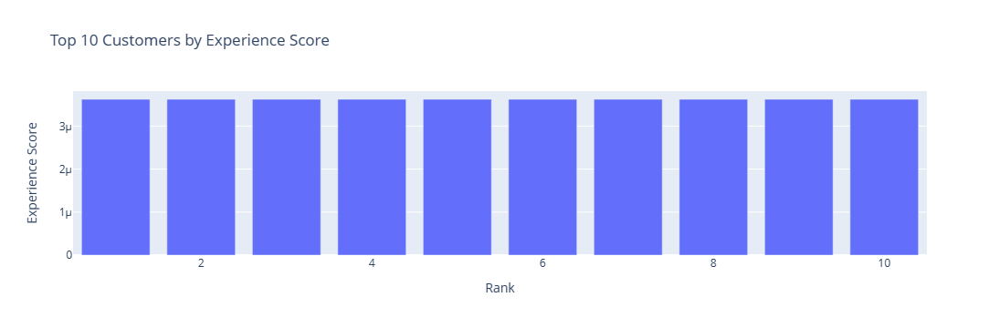

In [51]:
# Sort the DataFrame by 'experience_score' in descending order and select the top 10 rows
top_10_experience_customers = consolidated_data.sort_values(by='experience_score', ascending=False).head(10)

# Create a new DataFrame with the index as 'MSISDN/Number' and 'experience_score' as the only column
top_10_experience_df = pd.DataFrame({'experience_score': top_10_experience_customers['experience_score'].values})

# Reset the index to use default integer index (1, 2, 3, ...)
top_10_experience_df.reset_index(inplace=True, drop=True)

# Plot the top 10 customers using a bar chart with the default integer index as x-axis
fig = px.bar(top_10_experience_df, x=top_10_experience_df.index + 1, y='experience_score', title='Top 10 Customers by Experience Score')

# Customize the layout if needed
fig.update_layout(xaxis_title='Rank', yaxis_title='Experience Score')

# Show the plot
fig.show()

In [57]:
top_10_experience_customers = consolidated_data.sort_values(by='experience_score', ascending=False).head(10)

# Define columns to include in the resulting DataFrame
columns_to_include = [
    'MSISDN/Number',
    'experience_score',
]

# Create the resulting DataFrame
result_df = top_10_experience_customers[columns_to_include]

# Display the resulting DataFrame
print(result_df)

       MSISDN/Number  experience_score
62303   3.366620e+10          0.000004
21904   3.364746e+10          0.000004
21925   3.364754e+10          0.000004
21923   3.364753e+10          0.000004
21921   3.364753e+10          0.000004
93388   3.376077e+10          0.000004
21915   3.364749e+10          0.000004
79964   3.368309e+10          0.000004
45743   3.366181e+10          0.000004
45744   3.366181e+10          0.000004


In [45]:
top_10_experience_scores

,MSISDN/Number,Handset Type,TCP DL Retrans. Vol (Bytes),Avg RTT DL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),Sessions Frequency,Average Session Duration (ms),Total Traffic (Bytes),Cluster,Engagement Score,cluster,euclidean_distance,experience_score,satisfaction_score,Satisfaction Level,predicted_satisfaction_score
3,3.360101e+10,Apple iPhone 5S (A1457),1066.0,69.0,204.0,44.0,1,49920000.0,4.223207e+08,1,0.383222,0,1088.481163,0.000004,0.191613,Low Satisfied,0.191654
5,3.360101e+10,Samsung Galaxy A8 (2018),2760.0,21.0,3761.0,193.0,2,126990000.0,6.152172e+08,1,1.346446,0,4669.342576,0.000004,0.673225,Satisfied,0.673195
6,3.360101e+10,Huawei Mate 10 Pro Porsche Design Huawei Mate 10,98278.0,19.5,20485.5,771.0,2,64200000.0,6.547231e+08,1,1.099266,0,100393.351513,0.000004,0.549635,Satisfied,0.551216
7,3.360101e+10,Samsung Galaxy S8 Plus (Sm-G955F),278.0,49.0,747.0,500.0,1,86400000.0,3.326604e+08,1,0.497134,0,942.565197,0.000004,0.248569,Moderately Satisfied,0.250363
15,3.360103e+10,Apple iPhone 5S (A1457),32918.0,40.0,608.0,282.0,1,34560000.0,5.417800e+08,1,0.508405,0,32924.834146,0.000004,0.254204,Moderately Satisfied,0.253967
21,3.360103e+10,Apple iPhone 6S (A1688),1061.0,74.0,38.5,41.0,2,113370000.0,1.122863e+09,2,1.242807,0,1065.072085,0.000004,0.621405,Satisfied,0.623016
28,3.360105e+10,Apple iPhone 6 (A1586),1330.0,47.0,12122.0,646.0,1,31740000.0,2.504410e+08,1,0.785518,0,12212.256077,0.000004,0.392761,Moderately Satisfied,0.392696
31,3.360105e+10,Huawei P20 Pro,14247.0,40.0,11863.0,610.5,2,69360000.0,4.137920e+08,1,1.091958,0,18549.643278,0.000004,0.545981,Satisfied,0.546048
40,3.360107e+10,Apple iPhone 6S Plus (A1687),2980.0,27.0,60713.0,2152.0,1,86400000.0,1.152944e+08,1,0.892233,1,60822.181470,0.000004,0.446118,Moderately Satisfied,0.446250
41,3.360107e+10,Samsung Galaxy S9 Plus (Sm-G965F),28743.0,24.0,2589.0,314.0,1,32760000.0,3.737063e+08,1,0.617609,0,28861.094199,0.000004,0.308806,Moderately Satisfied,0.308848


In [20]:
# Define the columns to handle outliers
columns_to_handle_outliers = ['Engagement Score', 'experience_score']

# Function to handle outliers using IQR method
def handle_outliers_iqr(consolidated_data, columns):
    for column in columns:
        Q1 = consolidated_data[column].quantile(0.25)
        Q3 = consolidated_data[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_limit = Q1 - 1.5 * IQR
        upper_limit = Q3 + 1.5 * IQR
        consolidated_data[column] = consolidated_data[column].apply(lambda x: max(lower_limit, min(x, upper_limit)))
    return consolidated_data

# Apply the IQR method to handle outliers
consolidated_data = handle_outliers_iqr(consolidated_data, columns_to_handle_outliers)

In [21]:
# Calculate satisfaction score as the average of engagement and experience scores
consolidated_data['satisfaction_score'] = (user_engagement['Engagement Score'] + consolidated_data['experience_score']) / 2

# Sort the DataFrame by satisfaction score in descending order
top_satisfied_customers = consolidated_data.sort_values(by='satisfaction_score', ascending=False)

# Display the top 10 satisfied customers
top_10_satisfied_customers = top_satisfied_customers.head(10)
print("Top 10 Satisfied Customers:")
print(top_10_satisfied_customers[['MSISDN/Number', 'satisfaction_score']])


Top 10 Satisfied Customers:
       MSISDN/Number  satisfaction_score
13180   3.362578e+10           13.248594
6437    3.361489e+10           12.042311
13526   3.362632e+10           11.823997
92923   3.376054e+10           11.011010
37052   3.365973e+10           10.407587
76363   3.367588e+10           10.109175
71556   3.366926e+10            9.573468
45295   3.366172e+10            8.933542
1998    3.360750e+10            8.895862
65118   3.366716e+10            8.570206


In [22]:
consolidated_data

,MSISDN/Number,Handset Type,TCP DL Retrans. Vol (Bytes),Avg RTT DL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),Sessions Frequency,Average Session Duration (ms),Total Traffic (Bytes),Cluster,Engagement Score,cluster,euclidean_distance,experience_score,satisfaction_score
0,3.360100e+10,Huawei P20 Lite Huawei Nova 3E,1.685339e+07,46.000000,37.0,39.0,1,116760000.0,8.786906e+08,1,0.987749,0,1.685339e+07,5.933523e-08,0.493874
1,3.360100e+10,Apple iPhone 7 (A1778),1.685339e+07,30.000000,48.0,51.0,1,181260000.0,1.568596e+08,0,0.780296,0,1.685339e+07,5.933523e-08,0.390148
2,3.360100e+10,undefined,1.685339e+07,119.182869,48.0,49.0,1,135000000.0,5.959665e+08,0,0.789995,0,1.685339e+07,5.933523e-08,0.394998
3,3.360101e+10,Apple iPhone 5S (A1457),1.066000e+03,69.000000,204.0,44.0,1,49920000.0,4.223207e+08,1,0.383222,0,1.088481e+03,3.622936e-06,0.191613
4,3.360101e+10,Apple iPhone Se (A1723),9.349630e+06,57.000000,20197.5,8224.5,2,18600000.0,1.457411e+09,2,1.484564,1,9.349656e+06,1.069558e-07,0.742282
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106851,3.379000e+10,Huawei Honor 9 Lite,2.150440e+05,42.000000,9978.0,387.0,1,8760000.0,7.146416e+08,1,0.932555,0,2.152757e+05,3.622936e-06,0.466279
106852,3.379000e+10,Apple iPhone 8 Plus (A1897),1.685339e+07,34.000000,68.0,48.0,1,141000000.0,4.803073e+08,0,0.703592,0,1.685339e+07,5.933523e-08,0.351796
106853,3.197021e+12,Quectel Wireless. Quectel Ec25-E,1.685339e+07,119.182869,1.0,0.0,1,877380000.0,2.321240e+08,0,1.904089,0,1.685339e+07,5.933523e-08,4.764734
106854,3.370000e+14,Huawei B525S-23A,1.685339e+07,119.182869,11.0,22.0,1,253020000.0,5.962878e+08,0,0.888410,0,1.685339e+07,5.933523e-08,0.444205


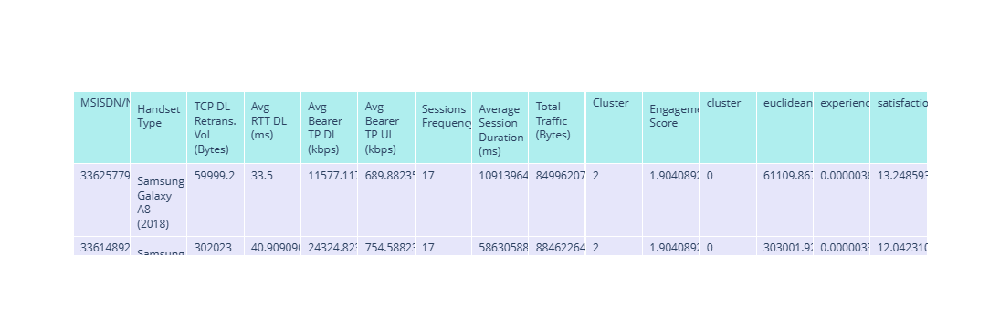

In [23]:
# Sort the DataFrame by satisfaction score in descending order
sorted_data = consolidated_data.sort_values(by='satisfaction_score', ascending=False)

# Get the top 10 entries
top_10 = sorted_data.head(10)

# Create a Plotly table
fig = go.Figure(data=[go.Table(
    header=dict(values=list(top_10.columns),
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[top_10[col] for col in top_10.columns],
               fill_color='lavender',
               align='left'))
])

# Show the figure
fig.show()

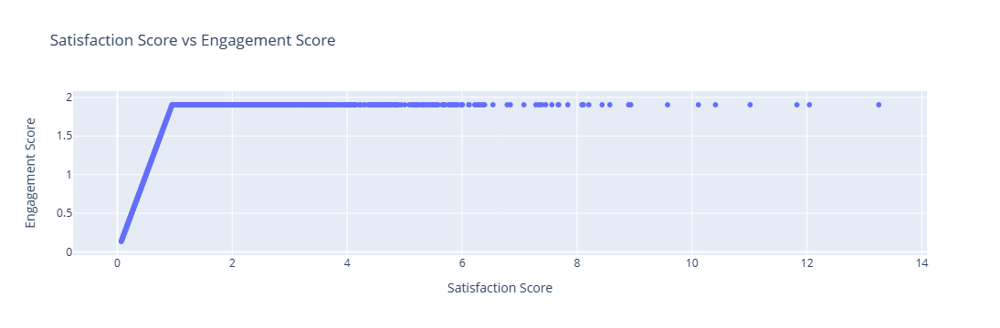

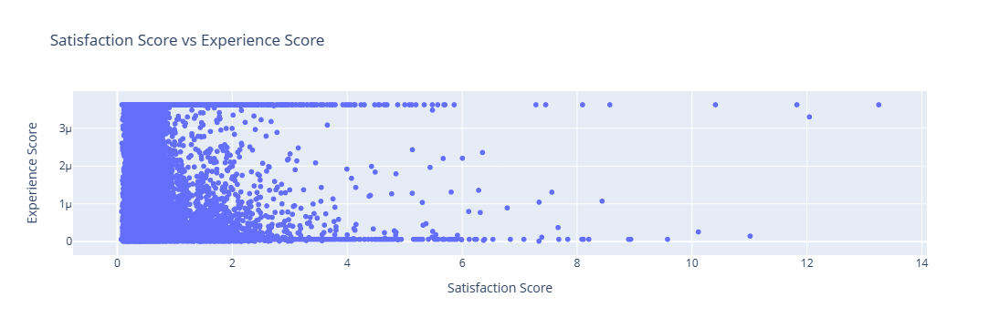

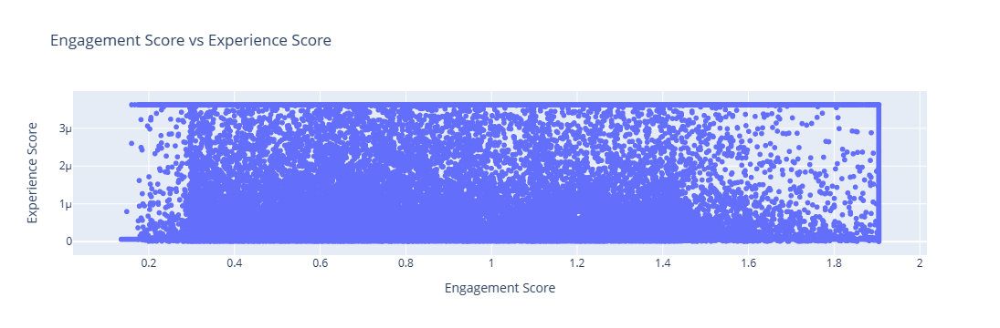

In [24]:
# Scatter plot: Satisfaction Score vs Engagement Score
fig1 = px.scatter(consolidated_data, x='satisfaction_score', y='Engagement Score',
                  title='Satisfaction Score vs Engagement Score',
                  labels={'satisfaction_score': 'Satisfaction Score',
                          'engagement_score': 'Engagement Score'})

# Scatter plot: Satisfaction Score vs Experience Score
fig2 = px.scatter(consolidated_data, x='satisfaction_score', y='experience_score',
                  title='Satisfaction Score vs Experience Score',
                  labels={'satisfaction_score': 'Satisfaction Score',
                          'experience_score': 'Experience Score'})

# Scatter plot: Engagement Score vs Experience Score
fig3 = px.scatter(consolidated_data, x='Engagement Score', y='experience_score',
                  title='Engagement Score vs Experience Score',
                  labels={'engagement_score': 'Engagement Score',
                          'experience_score': 'Experience Score'})

# Show the figures
fig1.show()
fig2.show()
fig3.show()

In [25]:
consolidated_data

,MSISDN/Number,Handset Type,TCP DL Retrans. Vol (Bytes),Avg RTT DL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),Sessions Frequency,Average Session Duration (ms),Total Traffic (Bytes),Cluster,Engagement Score,cluster,euclidean_distance,experience_score,satisfaction_score
0,3.360100e+10,Huawei P20 Lite Huawei Nova 3E,1.685339e+07,46.000000,37.0,39.0,1,116760000.0,8.786906e+08,1,0.987749,0,1.685339e+07,5.933523e-08,0.493874
1,3.360100e+10,Apple iPhone 7 (A1778),1.685339e+07,30.000000,48.0,51.0,1,181260000.0,1.568596e+08,0,0.780296,0,1.685339e+07,5.933523e-08,0.390148
2,3.360100e+10,undefined,1.685339e+07,119.182869,48.0,49.0,1,135000000.0,5.959665e+08,0,0.789995,0,1.685339e+07,5.933523e-08,0.394998
3,3.360101e+10,Apple iPhone 5S (A1457),1.066000e+03,69.000000,204.0,44.0,1,49920000.0,4.223207e+08,1,0.383222,0,1.088481e+03,3.622936e-06,0.191613
4,3.360101e+10,Apple iPhone Se (A1723),9.349630e+06,57.000000,20197.5,8224.5,2,18600000.0,1.457411e+09,2,1.484564,1,9.349656e+06,1.069558e-07,0.742282
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106851,3.379000e+10,Huawei Honor 9 Lite,2.150440e+05,42.000000,9978.0,387.0,1,8760000.0,7.146416e+08,1,0.932555,0,2.152757e+05,3.622936e-06,0.466279
106852,3.379000e+10,Apple iPhone 8 Plus (A1897),1.685339e+07,34.000000,68.0,48.0,1,141000000.0,4.803073e+08,0,0.703592,0,1.685339e+07,5.933523e-08,0.351796
106853,3.197021e+12,Quectel Wireless. Quectel Ec25-E,1.685339e+07,119.182869,1.0,0.0,1,877380000.0,2.321240e+08,0,1.904089,0,1.685339e+07,5.933523e-08,4.764734
106854,3.370000e+14,Huawei B525S-23A,1.685339e+07,119.182869,11.0,22.0,1,253020000.0,5.962878e+08,0,0.888410,0,1.685339e+07,5.933523e-08,0.444205


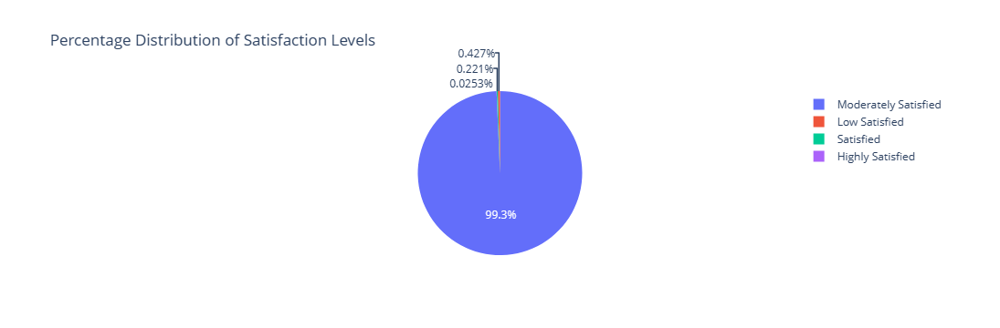

In [26]:
# Find the maximum satisfaction score in the dataset
max_satisfaction_score = consolidated_data['satisfaction_score'].max()

# Define thresholds for satisfaction categories relative to the highest score
low_satisfaction_threshold = 0.1



















0 * max_satisfaction_score
moderate_satisfaction_threshold = 0.25 * max_satisfaction_score
high_satisfaction_threshold = 0.50 * max_satisfaction_score

# Categorize individuals based on satisfaction levels
consolidated_data['Satisfaction Level'] = pd.cut(consolidated_data['satisfaction_score'],
                                  bins=[-float('inf'), low_satisfaction_threshold, moderate_satisfaction_threshold, high_satisfaction_threshold, float('inf')],
                                  labels=['Low Satisfied', 'Moderately Satisfied', 'Satisfied', 'Highly Satisfied'])

# Count the number of individuals in each satisfaction level category
satisfaction_counts = consolidated_data['Satisfaction Level'].value_counts()

# Calculate the percentage of individuals in each category
satisfaction_percentage = (satisfaction_counts / len(df)) * 100

# Create a pie chart
fig = px.pie(satisfaction_percentage, names=satisfaction_percentage.index, values=satisfaction_percentage.values,
             title='Percentage Distribution of Satisfaction Levels',
             labels={'index': 'Satisfaction Level', 'values': 'Percentage of Individuals'})

# Show the figure
fig.show()

In [27]:
# Define the columns to handle outliers
columns_to_handle_outliers = ['Engagement Score', 'experience_score', 'satisfaction_score']

# Function to handle outliers using IQR method
def handle_outliers_iqr(consolidated_data, columns):
    for column in columns:
        Q1 = consolidated_data[column].quantile(0.25)
        Q3 = consolidated_data[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_limit = Q1 - 1.5 * IQR
        upper_limit = Q3 + 1.5 * IQR
        consolidated_data[column] = consolidated_data[column].apply(lambda x: max(lower_limit, min(x, upper_limit)))
    return consolidated_data

# Apply the IQR method to handle outliers
consolidated_data = handle_outliers_iqr(consolidated_data, columns_to_handle_outliers)
consolidated_data.to_csv('consolidated_data.csv', index=False)

In [28]:
# Sort the DataFrame by satisfaction score in descending order
top_satisfied_customers = consolidated_data.sort_values(by='satisfaction_score', ascending=False)

# Display the top 10 satisfied customers
top_10_satisfied_customers = top_satisfied_customers.head(10)
print("Top 10 Satisfied Customers:")
print(top_10_satisfied_customers[['MSISDN/Number', 'satisfaction_score']])

Top 10 Satisfied Customers:
        MSISDN/Number  satisfaction_score
106855   8.823971e+14            0.952048
89674    3.369977e+10            0.952048
58679    3.366509e+10            0.952048
58668    3.366509e+10            0.952048
58641    3.366508e+10            0.952048
81620    3.368651e+10            0.952048
58631    3.366508e+10            0.952048
97608    3.376235e+10            0.952048
58622    3.366508e+10            0.952048
58607    3.366507e+10            0.952048


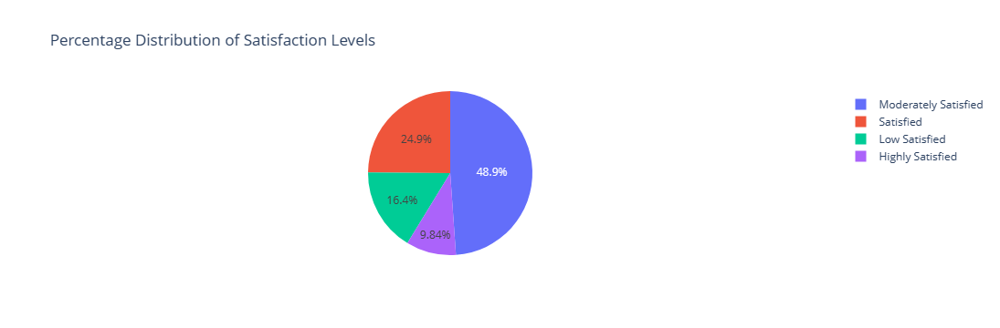

In [29]:
# Find the maximum satisfaction score in the dataset
max_satisfaction_score = consolidated_data['satisfaction_score'].max()

# Define thresholds for satisfaction categories relative to the highest score
low_satisfaction_threshold = 0.25 * max_satisfaction_score
moderate_satisfaction_threshold = 0.50 * max_satisfaction_score
high_satisfaction_threshold = 0.75 * max_satisfaction_score

# Categorize individuals based on satisfaction levels
consolidated_data['Satisfaction Level'] = pd.cut(consolidated_data['satisfaction_score'],
                                  bins=[-float('inf'), low_satisfaction_threshold, moderate_satisfaction_threshold, high_satisfaction_threshold, float('inf')],
                                  labels=['Low Satisfied', 'Moderately Satisfied', 'Satisfied', 'Highly Satisfied'])

# Count the number of individuals in each satisfaction level category
satisfaction_counts = consolidated_data['Satisfaction Level'].value_counts()

# Calculate the percentage of individuals in each category
satisfaction_percentage = (satisfaction_counts / len(df)) * 100

# Create a pie chart
fig = px.pie(satisfaction_percentage, names=satisfaction_percentage.index, values=satisfaction_percentage.values,
             title='Percentage Distribution of Satisfaction Levels',
             labels={'index': 'Satisfaction Level', 'values': 'Percentage of Individuals'})

# Show the figure
fig.show()

In [30]:
# Select features for the regression model
regression_features = ['Engagement Score', 'experience_score']

# Drop rows with missing values in the selected features
regression_data = consolidated_data.dropna(subset=regression_features)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    regression_data[regression_features],
    regression_data['satisfaction_score'],
    test_size=0.2, random_state=42
)

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize Ridge regression model with regularization parameter alpha
model = RidgeCV(alphas=[0.1, 1.0, 10.0], cv=5)

# Train the model on the training set
model.fit(X_train_scaled, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test_scaled)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Perform cross-validation
cv_scores = cross_val_score(model, X_train_scaled, y_train, cv=5)

consolidated_data['predicted_satisfaction_score'] = model.predict(consolidated_data[regression_features])

print(consolidated_data[['MSISDN/Number', 'satisfaction_score', 'predicted_satisfaction_score']])
print(f'Cross-validated R-squared scores: {cv_scores}')
print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')

        MSISDN/Number  satisfaction_score  predicted_satisfaction_score
0        3.360100e+10            0.493874                      0.632328
1        3.360100e+10            0.390148                      0.590667
2        3.360100e+10            0.394998                      0.592615
3        3.360101e+10            0.191613                      0.510926
4        3.360101e+10            0.742282                      0.732098
...               ...                 ...                           ...
106851   3.379000e+10            0.466279                      0.621244
106852   3.379000e+10            0.351796                      0.575263
106853   3.197021e+12            0.952048                      0.816347
106854   3.370000e+14            0.444205                      0.612378
106855   8.823971e+14            0.952048                      0.816347

[106856 rows x 3 columns]
Cross-validated R-squared scores: [1. 1. 1. 1. 1.]
Mean Squared Error: 2.5288455645228386e-13
R-squared: 0.99

C:\Users\Abel\Documents\10 Academy\Week-1\10-Academy-Week-1\week1\lib\site-packages\sklearn\base.py:458: UserWarning:

X has feature names, but RidgeCV was fitted without feature names



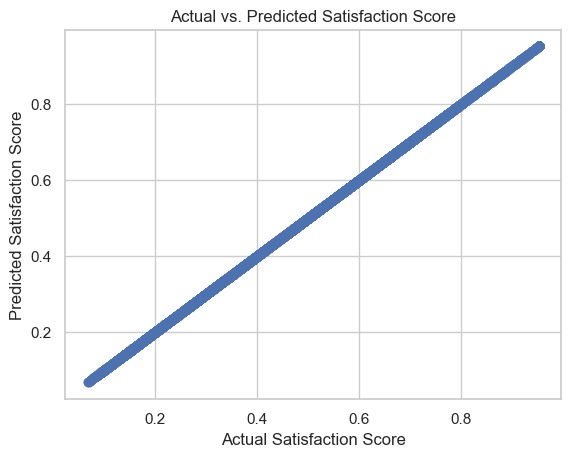

In [31]:
# Visualize predicted vs. actual values
plt.scatter(y_test, y_pred)
plt.xlabel('Actual Satisfaction Score')
plt.ylabel('Predicted Satisfaction Score')
plt.title('Actual vs. Predicted Satisfaction Score')
plt.show()

In [32]:
# Perform cross-validation
scores = cross_val_score(model, X_train_scaled, y_train, cv=5)
print(f'Cross-validated R-squared scores: {scores}')

Cross-validated R-squared scores: [1. 1. 1. 1. 1.]


In [33]:
# Select features for the regression model
regression_features = ['Engagement Score', 'experience_score']

# Drop rows with missing values in the selected features
regression_data = consolidated_data.dropna(subset=regression_features)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    regression_data[regression_features],
    regression_data['satisfaction_score'],
    test_size=0.2, random_state=42
)

# Initialize the Random Forest Regressor model
model = RandomForestRegressor(n_estimators=100, random_state=42)

# Train the model on the training set
model.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

consolidated_data['predicted_satisfaction_score'] = model.predict(consolidated_data[regression_features])

print(consolidated_data[['MSISDN/Number', 'satisfaction_score', 'predicted_satisfaction_score']])

# Perform cross-validation
cv_scores = cross_val_score(model, X_train, y_train, cv=5)
print(f'Cross-validated R-squared scores: {cv_scores}')
print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')

        MSISDN/Number  satisfaction_score  predicted_satisfaction_score
0        3.360100e+10            0.493874                      0.493874
1        3.360100e+10            0.390148                      0.390148
2        3.360100e+10            0.394998                      0.394997
3        3.360101e+10            0.191613                      0.191615
4        3.360101e+10            0.742282                      0.742283
...               ...                 ...                           ...
106851   3.379000e+10            0.466279                      0.466282
106852   3.379000e+10            0.351796                      0.351796
106853   3.197021e+12            0.952048                      0.952048
106854   3.370000e+14            0.444205                      0.444206
106855   8.823971e+14            0.952048                      0.952048

[106856 rows x 3 columns]
Cross-validated R-squared scores: [1.         1.         1.         0.99999999 0.99999999]
Mean Squared Error

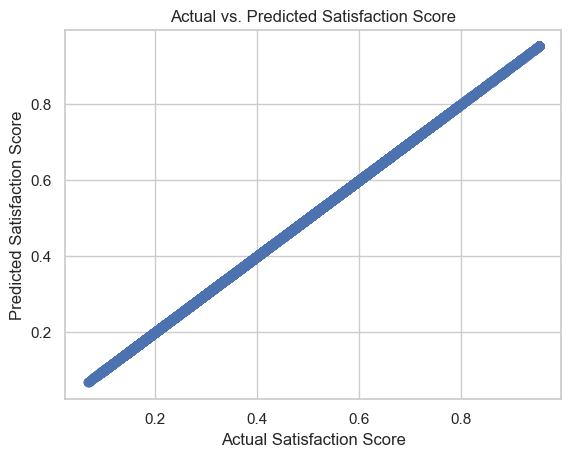

In [34]:
# Visualize predicted vs. actual values
plt.scatter(y_test, y_pred)
plt.xlabel('Actual Satisfaction Score')
plt.ylabel('Predicted Satisfaction Score')
plt.title('Actual vs. Predicted Satisfaction Score')
plt.show()

In [35]:
# Select features for the regression model
regression_features = ['Engagement Score', 'experience_score']

# Drop rows with missing values in the selected features
regression_data = consolidated_data.dropna(subset=regression_features)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    regression_data[regression_features],
    regression_data['satisfaction_score'],
    test_size=0.2, random_state=42
)

# Initialize the Gradient Boosting Regressor model
model = GradientBoostingRegressor(n_estimators=100, random_state=42)

# Train the model on the training set
model.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

consolidated_data['predicted_satisfaction_score'] = model.predict(consolidated_data[regression_features])

print(consolidated_data[['MSISDN/Number', 'satisfaction_score', 'predicted_satisfaction_score']])

# Perform cross-validation
cv_scores = cross_val_score(model, X_train, y_train, cv=5)
print(f'Cross-validated R-squared scores: {cv_scores}')
print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')

        MSISDN/Number  satisfaction_score  predicted_satisfaction_score
0        3.360100e+10            0.493874                      0.496788
1        3.360100e+10            0.390148                      0.392316
2        3.360100e+10            0.394998                      0.395124
3        3.360101e+10            0.191613                      0.191654
4        3.360101e+10            0.742282                      0.741186
...               ...                 ...                           ...
106851   3.379000e+10            0.466279                      0.466807
106852   3.379000e+10            0.351796                      0.351706
106853   3.197021e+12            0.952048                      0.951903
106854   3.370000e+14            0.444205                      0.445772
106855   8.823971e+14            0.952048                      0.951903

[106856 rows x 3 columns]
Cross-validated R-squared scores: [0.99993835 0.99994036 0.99993892 0.99993808 0.99993704]
Mean Squared Error

In [36]:
# Select features for k-means clustering
clustering_features = ['Engagement Score', 'experience_score']

# Drop rows with missing values in the selected features
clustering_data = consolidated_data.dropna(subset=clustering_features)

# Standardize features
scaler = StandardScaler()
clustering_data_scaled = scaler.fit_transform(clustering_data[clustering_features])

# Run k-means clustering with k=2
kmeans = KMeans(n_clusters=2, random_state=42)
clustering_data['cluster'] = kmeans.fit_predict(clustering_data_scaled)

# Display the results
print("Results of K-means Clustering (k=2):")
print(clustering_data[['MSISDN/Number', 'Engagement Score', 'experience_score', 'cluster']])

C:\Users\Abel\Documents\10 Academy\Week-1\10-Academy-Week-1\week1\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Results of K-means Clustering (k=2):
        MSISDN/Number  Engagement Score  experience_score  cluster
0        3.360100e+10          0.987749      5.933523e-08        0
1        3.360100e+10          0.780296      5.933523e-08        0
2        3.360100e+10          0.789995      5.933523e-08        0
3        3.360101e+10          0.383222      3.622936e-06        1
4        3.360101e+10          1.484564      1.069558e-07        0
...               ...               ...               ...      ...
106851   3.379000e+10          0.932555      3.622936e-06        1
106852   3.379000e+10          0.703592      5.933523e-08        0
106853   3.197021e+12          1.904089      5.933523e-08        0
106854   3.370000e+14          0.888410      5.933523e-08        0
106855   8.823971e+14          1.904089      5.933523e-08        0

[106856 rows x 4 columns]


In [37]:
# Select features for k-means clustering
clustering_features = ['Engagement Score', 'experience_score']

# Drop rows with missing values in the selected features
clustering_data = consolidated_data.dropna(subset=clustering_features)

# Standardize features
scaler = StandardScaler()
clustering_data_scaled = scaler.fit_transform(clustering_data[clustering_features])

# Run k-means clustering with k=2
kmeans = KMeans(n_clusters=3, random_state=42)
clustering_data['cluster'] = kmeans.fit_predict(clustering_data_scaled)

# Display the results
print("Results of K-means Clustering (k=2):")
print(clustering_data[['MSISDN/Number', 'Engagement Score', 'experience_score', 'cluster']])

C:\Users\Abel\Documents\10 Academy\Week-1\10-Academy-Week-1\week1\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Results of K-means Clustering (k=2):
        MSISDN/Number  Engagement Score  experience_score  cluster
0        3.360100e+10          0.987749      5.933523e-08        1
1        3.360100e+10          0.780296      5.933523e-08        1
2        3.360100e+10          0.789995      5.933523e-08        1
3        3.360101e+10          0.383222      3.622936e-06        2
4        3.360101e+10          1.484564      1.069558e-07        0
...               ...               ...               ...      ...
106851   3.379000e+10          0.932555      3.622936e-06        2
106852   3.379000e+10          0.703592      5.933523e-08        1
106853   3.197021e+12          1.904089      5.933523e-08        0
106854   3.370000e+14          0.888410      5.933523e-08        1
106855   8.823971e+14          1.904089      5.933523e-08        0

[106856 rows x 4 columns]


In [38]:
# Select features for k-means clustering
clustering_features = ['Engagement Score', 'experience_score']

# Drop rows with missing values in the selected features
clustering_data = consolidated_data.dropna(subset=clustering_features)

# Standardize features
scaler = StandardScaler()
clustering_data_scaled = scaler.fit_transform(clustering_data[clustering_features])

# Run k-means clustering with k=2
kmeans = KMeans(n_clusters=4, random_state=42)
clustering_data['cluster'] = kmeans.fit_predict(clustering_data_scaled)

# Display the results
print("Results of K-means Clustering (k=2):")
print(clustering_data[['MSISDN/Number', 'Engagement Score', 'experience_score', 'cluster']])

C:\Users\Abel\Documents\10 Academy\Week-1\10-Academy-Week-1\week1\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Results of K-means Clustering (k=2):
        MSISDN/Number  Engagement Score  experience_score  cluster
0        3.360100e+10          0.987749      5.933523e-08        0
1        3.360100e+10          0.780296      5.933523e-08        0
2        3.360100e+10          0.789995      5.933523e-08        0
3        3.360101e+10          0.383222      3.622936e-06        3
4        3.360101e+10          1.484564      1.069558e-07        2
...               ...               ...               ...      ...
106851   3.379000e+10          0.932555      3.622936e-06        3
106852   3.379000e+10          0.703592      5.933523e-08        0
106853   3.197021e+12          1.904089      5.933523e-08        2
106854   3.370000e+14          0.888410      5.933523e-08        0
106855   8.823971e+14          1.904089      5.933523e-08        2

[106856 rows x 4 columns]


In [39]:
# Group by the 'cluster' column and calculate the mean for 'satisfaction_score' and 'experience_score'
cluster_aggregation = clustering_data.groupby('cluster').agg({
    'satisfaction_score': 'mean',
    'experience_score': 'mean'
}).reset_index()

# Display the aggregated results
print("Average Scores per Cluster:")
print(cluster_aggregation)

Average Scores per Cluster:
   cluster  satisfaction_score  experience_score
0        0            0.325287      1.544855e-07
1        1            0.669974      3.489283e-06
2        2            0.688159      2.184876e-07
3        3            0.326219      3.479721e-06


In [40]:
# Define the SQL query for creating the table
create_table_query = """
CREATE TABLE user_scores (
    user_id VARCHAR(255),
    engagement_score FLOAT,
    experience_score FLOAT,
    satisfaction_score FLOAT
);
"""

In [41]:
# Execute the query
db_connection.execute_query(create_table_query)

Error executing query: (psycopg2.errors.DuplicateTable) relation "user_scores" already exists

[SQL: 
CREATE TABLE user_scores (
    user_id VARCHAR(255),
    engagement_score FLOAT,
    experience_score FLOAT,
    satisfaction_score FLOAT
);
]
(Background on this error at: https://sqlalche.me/e/20/f405)


In [42]:
user_scores_df = consolidated_data[['MSISDN/Number', 'Engagement Score', 'experience_score', 'satisfaction_score']]

In [43]:
# Insert data into the 'user_scores' table
user_scores_df.to_sql('user_scores', con=db_connection.engine, index=False, if_exists='append')

# Close the database connection
db_connection.close_connection()

Connection closed.
